### Once we have a trained SOM we want to plot the results with a color map plot. 

In [1]:
%matplotlib inline 
import numpy as np 
from matplotlib import pyplot as plt 
import pandas as pd
from astropy.table import Table, Column
import os
import matplotlib.patches as patches
import pickle

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer modern"],  # You can change the serif font here if needed
    "axes.labelsize": 14,     # Adjust as needed
    "axes.linewidth": 0.5,    # Adjust line width if necessary
    "xtick.labelsize": 12,    # Adjust tick label size
    "ytick.labelsize": 12,    # Adjust tick label size
    "legend.fontsize": 12,    # Adjust legend font size
    "legend.handlelength": 2.0
})

In [2]:

path='/your/path/'
trained_som='your/.fits'

data=Table.read(os.path.join(path,trained_som))

a=len(data)

data #this will print the data table

In [3]:
somres=64 #the resolution of the SOM must be the same size as in the training
cell_classifications = data['cell'].data
counts, _ = np.histogram(cell_classifications, bins=somres**2, range=(0,somres**2))

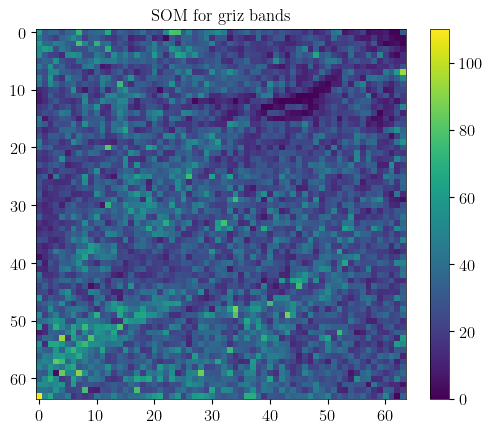

In [4]:
#plot the resulting color map

plt.imshow(counts.reshape(somres,somres))
plt.title('SOM for griz bands')
plt.colorbar()

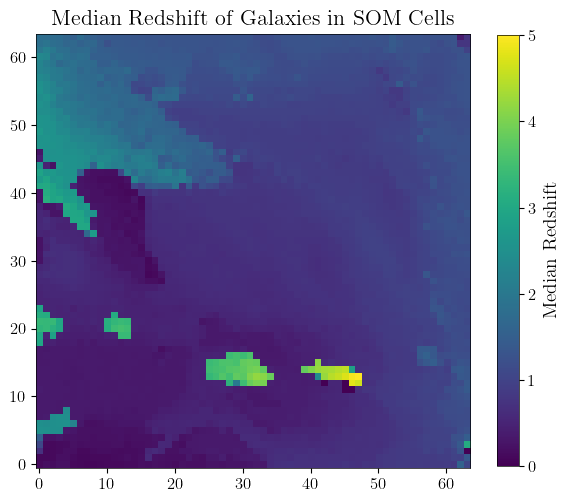

In [5]:
#Median redshift of each cell 
import statistics as ss

pixels_redshift = [[] for _ in range(somres * somres)] #llista de llista

z_values = data['photoz']

output_dir='your/path'

for i in range(len(data)):
    cell_index = cell_classifications[i]
    redshift = z_values[i]
    pixels_redshift[cell_index].append(redshift)


med_redshifts = []
for z in pixels_redshift:
    if z:
        k = [round(i, 4) for i in z] 
        med_redshifts.append(ss.median(k))
    else:
        med_redshifts.append(0)


median_redshift_map = np.array(med_redshifts).reshape(somres, somres)

plt.figure(figsize=(7,7))
plt.imshow(median_redshift_map, cmap='viridis', interpolation='nearest')
cbar=plt.colorbar(label='Median Redshift', shrink=0.8)
plt.title('Median Redshift of Galaxies in SOM Cells', size=16)
cbar.ax.yaxis.label.set_size(14)
plt.gca().invert_yaxis() 
plt.savefig(os.path.join(output_dir, f'median_z.png'),bbox_inches='tight', dpi=300 )
plt.show()


/home/nina/som_env/lib/python3.10/site-packages/numpy/_core/_methods.py:218: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/nina/som_env/lib/python3.10/site-packages/numpy/_core/_methods.py:175: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/nina/som_env/lib/python3.10/site-packages/numpy/_core/_methods.py:210: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/nina/som_env/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/nina/som_env/lib/python3.10/site-packages/numpy/_core/_methods.py:138: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


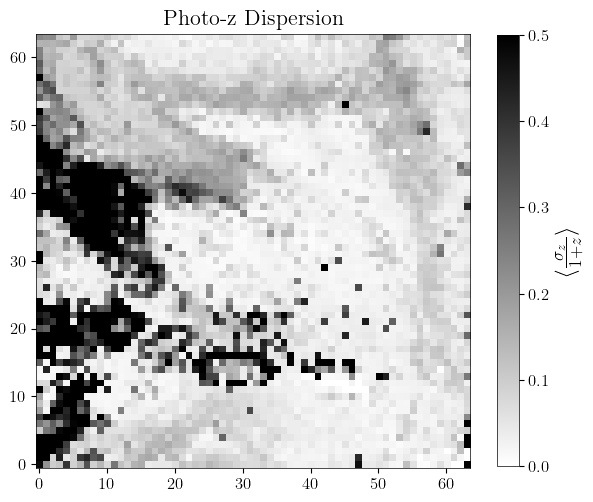

In [6]:
#Photo z dispersion

output_dir2='your/path'

z_cells=[[] for i in range(somres**2)]
z_values = data['photoz']

a=len(data)

for i in range(a):
    cell_index=cell_classifications[i]
    z=z_values[i]
    z_cells[cell_index].append(z)
    

sigma=[]

for z in z_cells:
    if z:
        sigma.append(np.std(z))
    else:
        sigma.append(np.std(z))

dispersion=[[] for i in range(somres**2)]

dispersion_med=[]

for i in range(len(z_cells)):
    for z in z_cells[i]:
        dispersion[i].append(sigma[i]/(1+z))
    
    dispersion_med.append(np.mean(dispersion[i]))
        
               

plt.figure(figsize=(7,7))
photoz_dispersion=np.array(dispersion_med).reshape(somres, somres)
plt.imshow(photoz_dispersion, cmap='binary', interpolation='nearest', vmin=0.0, vmax=0.5)
cbar = plt.colorbar(shrink=0.8)
cbar.set_label(r'$\langle\frac{\sigma_z}{1+z}\rangle$', fontsize=18)
plt.gca().invert_yaxis()
plt.title('Photo-z Dispersion',size=16)
plt.savefig(os.path.join(output_dir2, f'pz_dispersion.png'),bbox_inches='tight',dpi=300)
plt.show()




## Galaxy Classification: Red and Blue

Galaxies are typically classified into two main types based on their color: **red galaxies** and **blue galaxies**.  

However, the criteria for this classification depend on the **reference frame** used for observation. Specifically, we study two of these:  

1. **Observer Frame**  
   - Classification is based on the photometric fluxes (the light intensity at different wavelengths) received directly by the observer.  

2. **Rest Frame**  
   - Classification is based on the galaxy's intrinsic properties, as determined by spectroscopy.  
   - This corrects for redshift effects, effectively showing the galaxy as it would appear in its local environment without the influence of its motion or distance.  

By using these two reference frames, we can gain complementary insights into how galaxies are perceived from Earth versus their true, rest-frame characteristics.


### Creating the `type_rest` Column for Galaxy Classification in The Rest Frame

We create a new column in our dataset called `type_rest`, which will classify the type of galaxy based on its **rest-frame properties**.

To perform this classification, we rely on the existing column `lp_model` in our data. Using the **BC03 template** (refer to the section *LP_Galaxy_Models/Opening_BC03_Templates.ipynb* in the repository for details), we define the classification as follows:  
- **Red Galaxies**: `lp_model = 1, 2, 3`  
- **Blue Galaxies**: `lp_model = 4, 5, ..., 12`  

This mapping allows us to assign each galaxy to its respective type (`red` or `blue`) based on the value of `lp_model`.


In [7]:
new_column=Column(np.zeros(len(data)),'type_rest')
data.add_column(new_column)


def convert_to_nan(value):
    try:
        return float(value)
    except ValueError:
        return np.nan

data['lp_model'] = np.array([convert_to_nan(x) for x in data['lp_model']])

count=0
countr=0
countb=0

for i in range(len(data)): #len(data)
    if data['lp_model'][i]<=3: 
        data['type_rest'][i]=1 #red
        countr+=1
        
    else:
        data['type_rest'][i]=2 #blue
        countb+=1
    if np.isnan(data['lp_model'][i]):
        data['type_rest'][i]=0
        count+=1

print('Unknown type count:', count)
print('Red galaxy count:', countr)
print('Blue galaxy count:', countb)




/tmp/ipykernel_6450/2587841801.py:7: UserWarning: Warning: converting a masked element to nan.
  return float(value)


Unknown type count: 269
Red galaxy count: 24971
Blue galaxy count: 96595


### Creating the `type_obs` Column for Galaxy Classification in The Rest Frame
For classifying galaxies in the **observer frame**, we use photometric flux bands `g` and `r`. Specifically, we calculate the color index `g - r` and classify galaxies as follows:  

- **Blue Galaxies**: `g - r < 0.7`  
- **Red Galaxies**: `g - r ≥ 0.7`  

This classification is based on the observed fluxes and provides a perception of the galaxy's color directly from the data received by the observer (Fritz et al. (2014))



In [8]:
new_col=Column(np.ones(len(data)),'type_obs')
data.add_column(new_col)

def convert_to_nan(value):
    try:
        return float(value)
    except ValueError:
        return np.nan

data['g-r'] = np.array([convert_to_nan(x) for x in data['g-r']])

count=0
countr=0
countb=0

for i in range(len(data)): #len(data)
    if data['g-r'][i]<0.7:  #blue
        data['type_obs'][i]=2
        countb+=1
        
    else:
        data['type_obs'][i]=1 #red
        countr+=1
    if np.isnan(data['g-r'][i]):
        data['type_obs'][i]=0
        count+=1

print('Unknown type count:', count)
print('Red galaxy count:', countr)
print('Blue galaxy count:', countb)



/tmp/ipykernel_6450/1601002071.py:6: UserWarning: Warning: converting a masked element to nan.
  return float(value)


Unknown type count: 75
Red galaxy count: 46496
Blue galaxy count: 75070


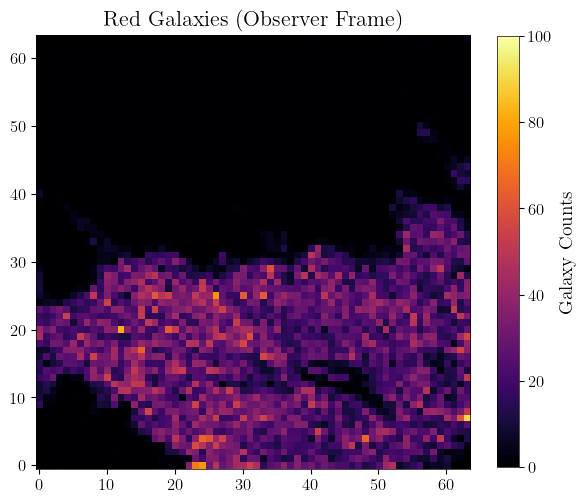

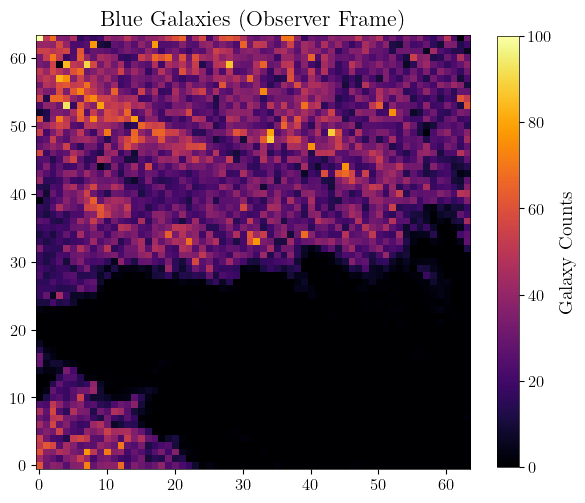

In [8]:
#Som of red and blue galaxies in the observer frame
output_dir3='you/path'

for i in range(1,3): # range over the galaxy types

    mask = (data['type_obs']==i) 
    data_selection = data[mask] 
    
    # histogram of the selected data
    cell_classifications = data_selection['cell'].data
    counts, _ = np.histogram(cell_classifications, bins=somres**2, range=(0,somres**2))
    show_colorbar = True
  
    names=[0,'Red', 'Blue'] 
    # plot the results
    plt.figure(figsize=(7,7))
    heatmap=plt.imshow(counts.reshape(somres,somres), cmap='inferno', vmin=0,vmax=100)
    plt.title(str(names[i])+' Galaxies (Observer Frame)',size=16)
    if show_colorbar:  
        cbar=plt.colorbar(heatmap, label='Galaxy Counts', shrink=0.8)
        cbar.ax.yaxis.label.set_size(14)
    plt.gca().invert_yaxis() 
    plt.savefig(os.path.join(output_dir3,"%01d"%i+"rvsb_label.png"), bbox_inches='tight', dpi=300)
    plt.show()
    

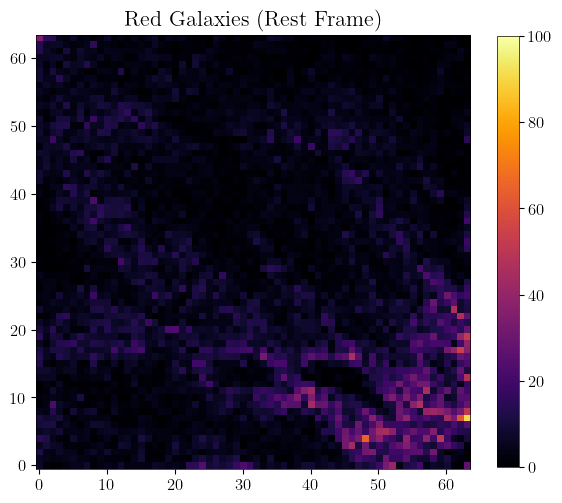

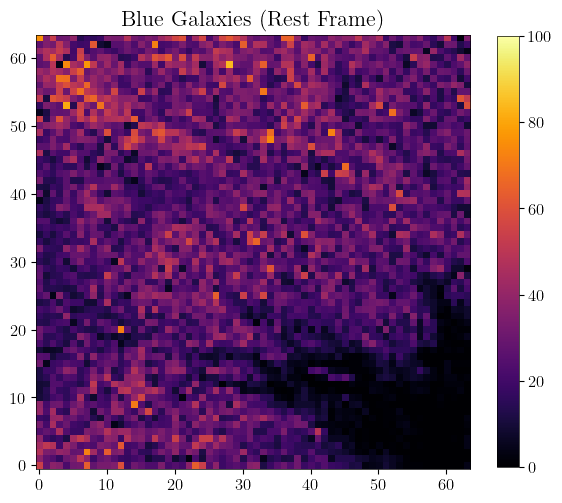

In [10]:
#Som of red and blue galaxies in the rest frame

output_dir4='your/path'

for i in range(1,3): # range over the galaxy types

    mask = (data['type_rest']==i) 
    data_selection = data[mask] 
    
    # histogram of the selected data
    cell_classifications = data_selection['cell'].data
    counts, _ = np.histogram(cell_classifications, bins=somres**2, range=(0,somres**2))
    show_colorbar = True
  
    names=[0,'Red', 'Blue'] 
    # plot the results
    plt.figure(figsize=(7,7))
    heatmap=plt.imshow(counts.reshape(somres,somres), cmap='inferno', vmin=0,vmax=100)
    plt.title(str(names[i])+' Galaxies (Rest Frame)',size=16)
    if show_colorbar:  
        cbar=plt.colorbar(heatmap, label='', shrink=0.8)
        cbar.ax.yaxis.label.set_size(14)
    plt.gca().invert_yaxis() 
    plt.savefig(os.path.join(output_dir4,"%01d"%i+"rvsb_nolabel_rest.png"), bbox_inches='tight', dpi=300)
    plt.show()
    

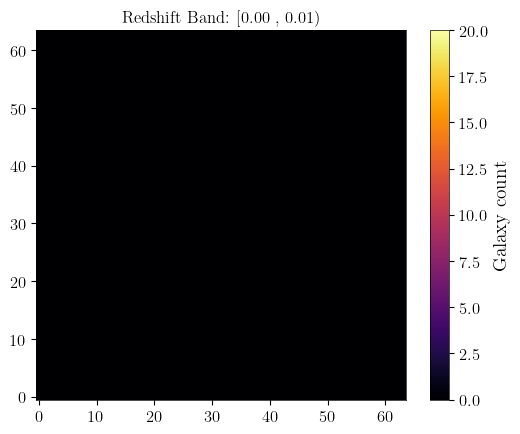

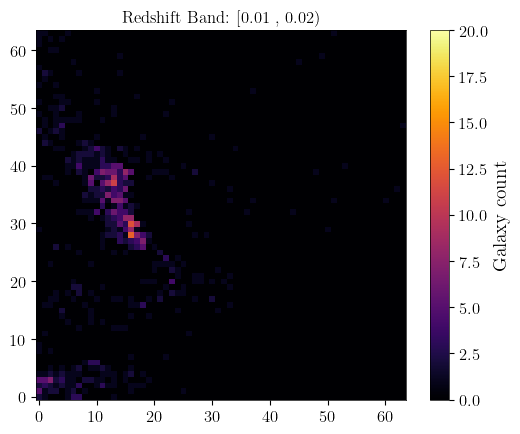

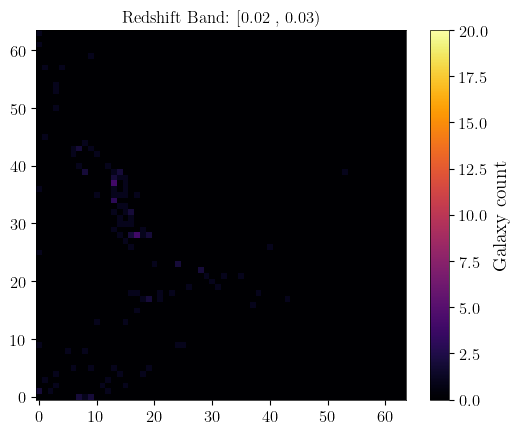

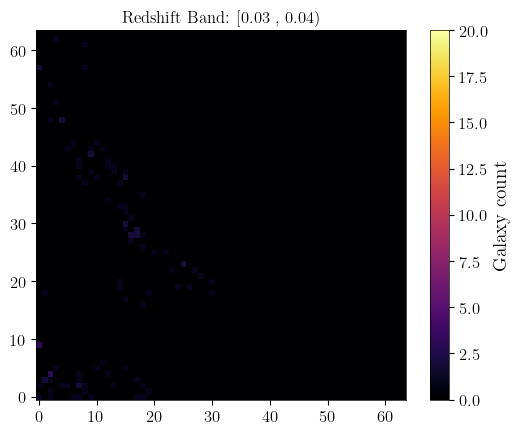

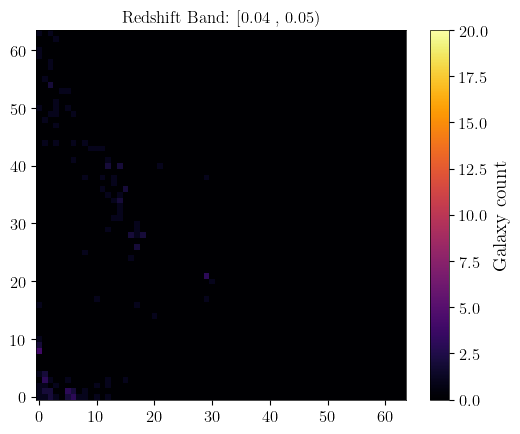

...

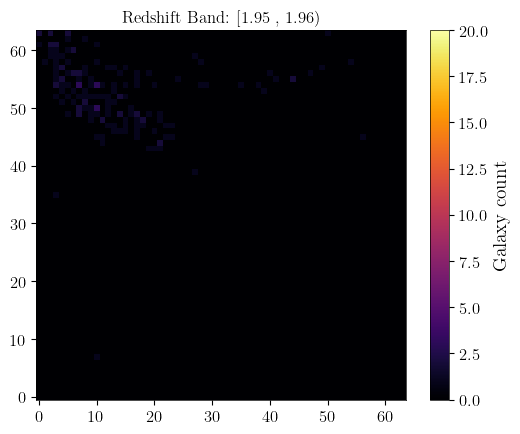

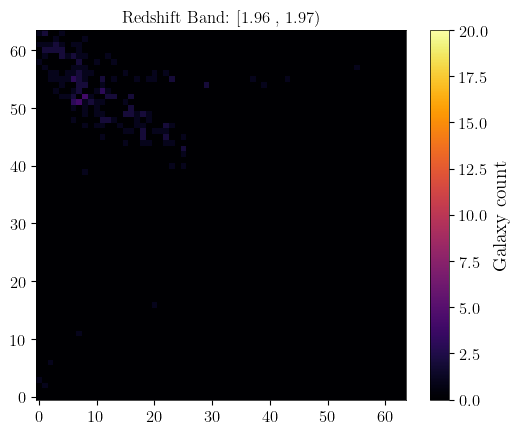

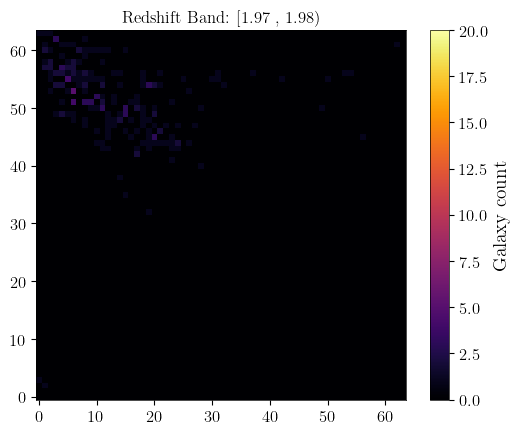

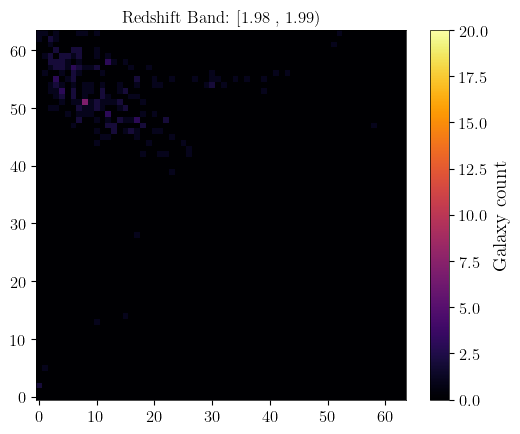

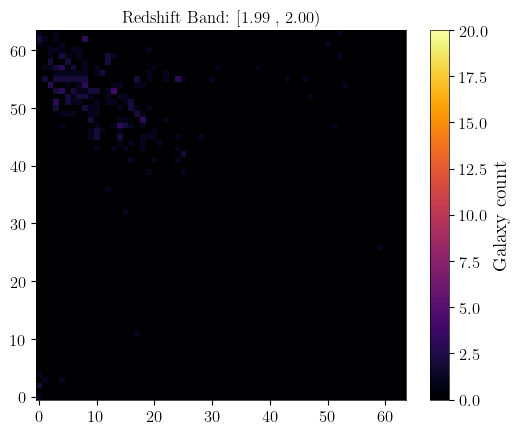

In [30]:
#Evolution of galaxy distribution across redshift. This aims to create an animation. 

output_dir5='your/path'

Delta_z = 0.01
steps = 200
z=0

nsrc=len(data)

data['band'] = None  

for s in range(steps):
    z += Delta_z

    for row in data:
        
        if z - Delta_z <= row['photoz'] < z:
            row['band'] = s

    
    band_s = data[data['band'] == s]
    
    cell_classifications = band_s['cell']
    
    counts, _ = np.histogram(cell_classifications, bins=somres**2, range=(0, somres**2))
    
    heatmap = plt.imshow(counts.reshape(somres,somres), cmap='inferno', vmin=0, vmax=20) 
    #plt.imshow(counts.reshape(somres,somres))
    plt.title(f'Redshift Band: [{z - Delta_z:.2f} , {z:.2f})')
    plt.gca().invert_yaxis() 
    plt.colorbar(heatmap, label='Galaxy count')
    plt.savefig(os.path.join(output_dir4, f'band_{s:03d}.png'))
    plt.show()

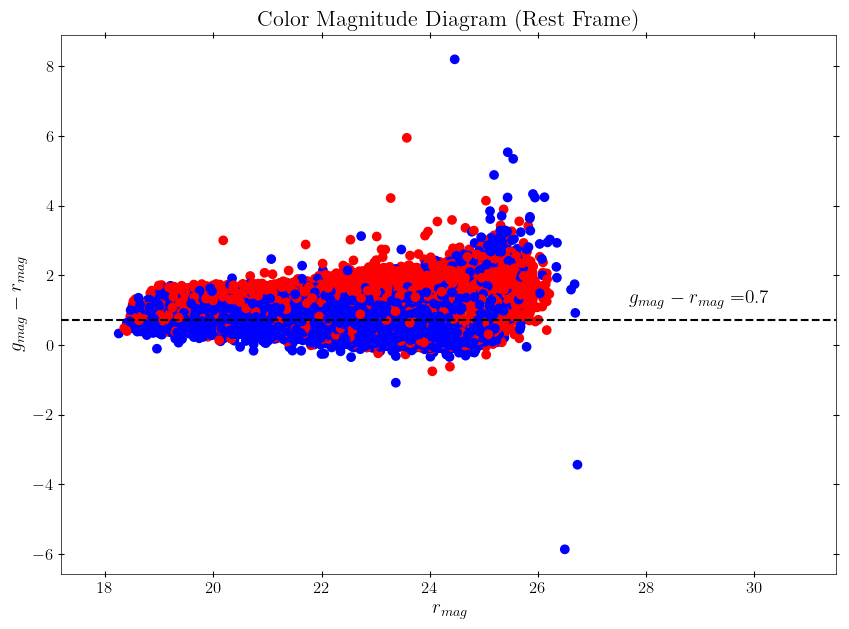

In [9]:
#color magnitude diagram (rest frame)

r_mag=data['r_MAG']
b_mag=data['g_MAG']

output_dir6='your/path'


n=len(r_mag)

b1, b2, b3 = 'g', 'r', 'i'

resta = b_mag - r_mag


fig, ax = plt.subplots(figsize=(10, 7))
sc = ax.scatter(r_mag, resta, c=data['type_rest'], cmap='brg_r')
ax.set_xlabel(r'$r_{mag}$')
ax.set_ylabel(r'$g_{mag} - r_{mag}$')
plt.xlim(min(r_mag)-1,max(r_mag)+2)
ax.hlines(0.7, xmin=min(r_mag)-1, xmax=max(r_mag)+2, color='black', linestyles='dashed')
ax.annotate(r'$g_{mag} - r_{mag}=$'  + str(0.7), xy=(28,0.7 ), xytext=(29, 0.7+0.5), fontsize=14, ha='center')
plt.title('Color Magnitude Diagram (Rest Frame)', size=16)


ax.tick_params(axis='both',       
                which='both',      
                bottom=True,       
                top=True,          
                left=True,         
                right=True,        
                direction='inout', 
                length=4)          

plt.savefig(os.path.join(output_dir6,"color_mag_diagram_rest.png"), bbox_inches='tight', dpi=300)

plt.show()



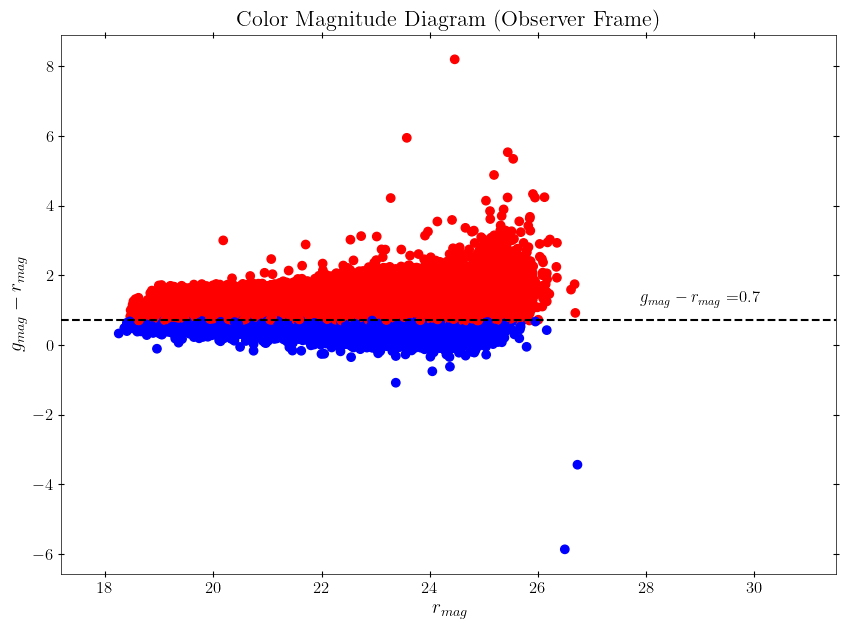

In [10]:
#color magnitude diagram(observer frame)

r_mag=data['r_MAG']
b_mag=data['g_MAG']
output_dir7='your/path'

b1, b2, b3 = 'g', 'r', 'i'

resta = b_mag - r_mag


fig, ax = plt.subplots(figsize=(10, 7))
sc = ax.scatter(r_mag, resta, c=data['type_obs'], cmap='bwr_r')
ax.set_xlabel(r'$r_{mag}$')
ax.set_ylabel(r'$g_{mag} - r_{mag}$')
plt.xlim(min(r_mag)-1,max(r_mag)+2)
ax.hlines(0.7, xmin=min(r_mag)-1, xmax=max(r_mag)+2, color='black', linestyles='dashed')
ax.annotate(r'$g_{mag} - r_{mag}=$'  + str(0.7), xy=(28,0.7 ), xytext=(29, 0.7+0.5), fontsize=12, ha='center')
plt.title('Color Magnitude Diagram (Observer Frame)', size=16)

ax.tick_params(axis='both',       
                which='both',      
                bottom=True,       
                top=True,          
                left=True,         
                right=True,        
                direction='inout', 
                length=4)          

plt.savefig(os.path.join(output_dir7,"color_mag_diagram_obs.png"), bbox_inches='tight', dpi=300)

plt.show()



### Statistics of Galaxy Types: Blue and Red

To analyze the distribution of galaxy types, we compute the following:

1. **Probability Distribution**  
   - For both the **observer frame** and the **rest frame**, we calculate the probability of finding a blue or red galaxy within specific redshift bins.  
   - This involves normalizing the counts of red and blue galaxies in each redshift bin to determine their relative probabilities.

2. **Density Histogram**  
   - We construct density histograms to visualize the distribution of galaxy types as a function of redshift.  
   - This provides insights into how the fraction of blue and red galaxies evolves across different redshift ranges.  

These analyses help us explore differences in galaxy classification between the observer and rest frames, as well as trends in galaxy populations over cosmic time.


Length of data: 121566


/home/nina/som_env/lib/python3.10/site-packages/numpy/polynomial/polynomial.py:1467: RankWarning: The fit may be poorly conditioned
  return pu._fit(polyvander, x, y, deg, rcond, full, w)
/home/nina/som_env/lib/python3.10/site-packages/numpy/polynomial/polynomial.py:1467: RankWarning: The fit may be poorly conditioned
  return pu._fit(polyvander, x, y, deg, rcond, full, w)


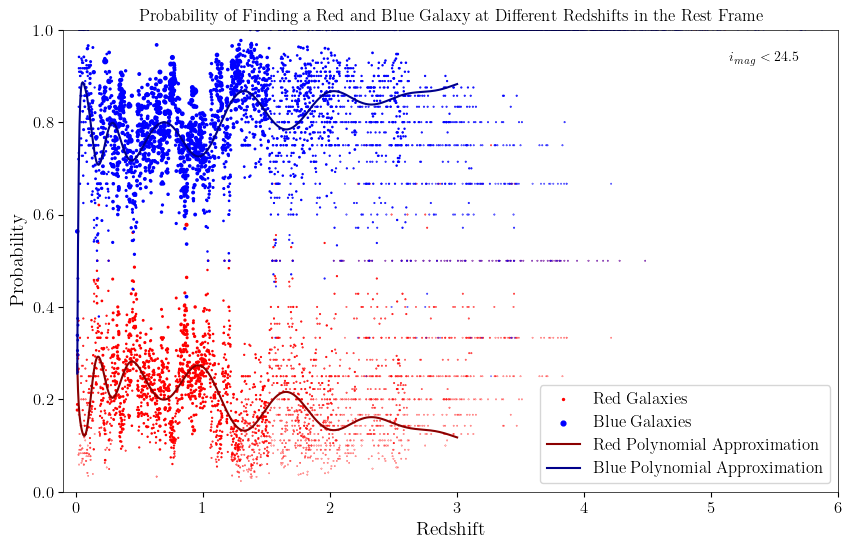

In [11]:
from collections import defaultdict
from numpy.polynomial.polynomial import Polynomial

output_dir8a='your/path'

# Probability plot in the rest frame
a_rest = len(data)
print(f"Length of data: {a_rest}")

red_counts_rest = defaultdict(int)
blue_counts_rest = defaultdict(int)
total_counts_rest = defaultdict(int)

for photoz, typ in zip(data['photoz'], data['type_rest']):
    redshift_bin_rest = round(photoz, 3)
    total_counts_rest[redshift_bin_rest] += 1
    if typ == 1:  # red
        red_counts_rest[redshift_bin_rest] += 1
    if typ == 2:  # blue
        blue_counts_rest[redshift_bin_rest] += 1

redshift_bins_rest = sorted(total_counts_rest.keys())

prob_red_rest = [red_counts_rest[z] / total_counts_rest[z] for z in redshift_bins_rest]
prob_blue_rest = [blue_counts_rest[z] / total_counts_rest[z] for z in redshift_bins_rest]

degree_rest = 50 
poly_red_rest = Polynomial.fit(redshift_bins_rest, prob_red_rest, degree_rest)
poly_blue_rest = Polynomial.fit(redshift_bins_rest, prob_blue_rest, degree_rest)

x_new_rest = np.linspace(min(redshift_bins_rest), 3, 500)
y_red_new_rest = poly_red_rest(x_new_rest)
y_blue_new_rest = poly_blue_rest(x_new_rest)

blue_counts_array_rest = np.array([blue_counts_rest[z] for z in redshift_bins_rest])
red_counts_array_rest = np.array([red_counts_rest[z] for z in redshift_bins_rest])

plt.figure(figsize=(10, 6))
plt.scatter(redshift_bins_rest, prob_red_rest, s=0.05*red_counts_array_rest, color='red', label='Red Galaxies')
plt.scatter(redshift_bins_rest, prob_blue_rest, s=0.05*blue_counts_array_rest, color='blue', label='Blue Galaxies')
plt.plot(x_new_rest, y_red_new_rest, color='darkred', label='Red Polynomial Approximation')
plt.plot(x_new_rest, y_blue_new_rest, color='darkblue', label='Blue Polynomial Approximation')
plt.xlabel('Redshift')
plt.ylabel('Probability')
plt.xlim(-0.1, 6)
plt.ylim(0, 1)
plt.title('Probability of Finding a Red and Blue Galaxy at Different Redshifts in the Rest Frame')
plt.legend(loc='lower right')
textstr = r'$i_{mag}<24.5$'

plt.text(0.95, 0.95, textstr, transform=plt.gca().transAxes, fontsize=10,
         verticalalignment='top', horizontalalignment='right')
plt.savefig(os.path.join(output_dir8a, 'galaxies_prob_rest_ilim.png'), dpi=300)
plt.show()


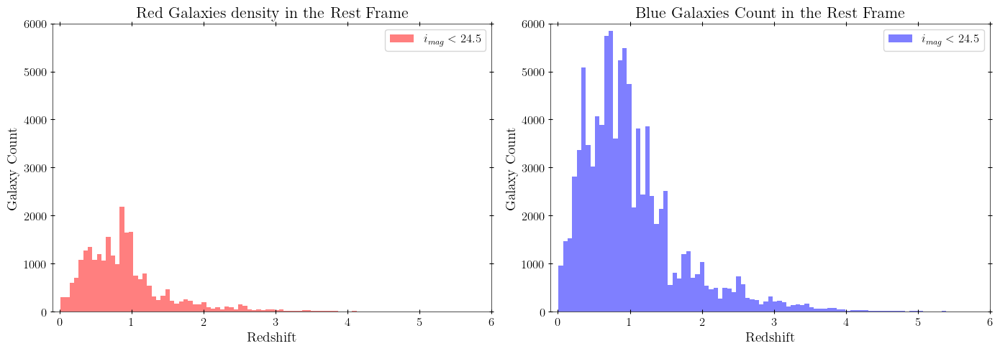

In [44]:
#Histogram in the rest frame

red_counts_array_rest = np.array([red_counts_rest[z] for z in redshift_bins_rest])
blue_counts_array_rest = np.array([blue_counts_rest[z] for z in redshift_bins_rest])

output_dir8b='your/path'

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Plot for Red Galaxies
ax1.hist(np.array(redshift_bins_rest), bins=100, weights=red_counts_array_rest, color='red', density=False, alpha=0.5, label=r'$i_{mag}<24.5$')
ax1.set_ylim(0, 6000)
ax1.set_xlim(-0.1, 6)
ax1.set_xlabel('Redshift')
ax1.set_ylabel('Galaxy Count')
ax1.set_title('Red Galaxies density in the Rest Frame', size=16)
ax1.tick_params(axis='both', which='both', bottom=True, top=True, left=True, right=True, direction='inout', length=4)
ax1.legend()

# Plot for Blue Galaxies
ax2.hist(np.array(redshift_bins_rest), bins=100, weights=blue_counts_array_rest, color='blue', density=False, alpha=0.5, label=r'$i_{mag}<24.5$')
ax2.set_ylim(0, 6000)
ax2.set_xlim(-0.1, 6)
ax2.set_xlabel('Redshift')
ax2.set_ylabel('Galaxy Count')
ax2.set_title('Blue Galaxies Count in the Rest Frame', size=16)
ax2.tick_params(axis='both', which='both', bottom=True, top=True, left=True, right=True, direction='inout', length=4)
ax2.legend()

plt.tight_layout()
plt.savefig(os.path.join(output_dir8b, 'galaxies_hist_rest_ilim.png'), dpi=300)
plt.show()


/home/nina/som_env/lib/python3.10/site-packages/numpy/polynomial/polynomial.py:1467: RankWarning: The fit may be poorly conditioned
  return pu._fit(polyvander, x, y, deg, rcond, full, w)
/home/nina/som_env/lib/python3.10/site-packages/numpy/polynomial/polynomial.py:1467: RankWarning: The fit may be poorly conditioned
  return pu._fit(polyvander, x, y, deg, rcond, full, w)


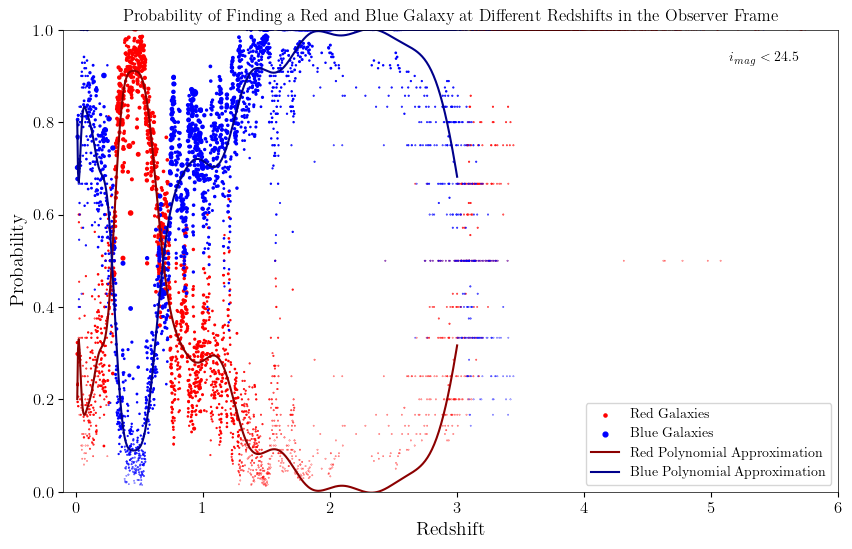

In [12]:
from collections import defaultdict
from numpy.polynomial.polynomial import Polynomial

#Probability in the observer frame

output_dir9a='your/path'

red_counts_obs = defaultdict(int)
blue_counts_obs = defaultdict(int)
total_counts_obs = defaultdict(int)

for photoz, typ in zip(data['photoz'], data['type_obs']):
    redshift_bin_obs = round(photoz, 3)
    total_counts_obs[redshift_bin_obs] += 1
    if typ == 1:  # red
        red_counts_obs[redshift_bin_obs] += 1
    if typ == 2:  # blue
        blue_counts_obs[redshift_bin_obs] += 1

redshift_bins_obs = sorted(total_counts_obs.keys())

prob_red_obs = [red_counts_obs[z] / total_counts_obs[z] for z in redshift_bins_obs]
prob_blue_obs = [blue_counts_obs[z] / total_counts_obs[z] for z in redshift_bins_obs]

degree_obs = 100
poly_red_obs = Polynomial.fit(redshift_bins_obs, prob_red_obs, degree_obs)
poly_blue_obs = Polynomial.fit(redshift_bins_obs, prob_blue_obs, degree_obs)

x_new_obs = np.linspace(min(redshift_bins_obs), 3, 500)
y_red_new_obs = poly_red_obs(x_new_obs)
y_blue_new_obs = poly_blue_obs(x_new_obs)

blue_counts_array_obs = np.array([blue_counts_obs[z] for z in redshift_bins_obs])
red_counts_array_obs = np.array([red_counts_obs[z] for z in redshift_bins_obs])

plt.figure(figsize=(10, 6))
plt.scatter(redshift_bins_obs, prob_red_obs, s=0.05 * red_counts_array_obs, color='red', label='Red Galaxies')
plt.scatter(redshift_bins_obs, prob_blue_obs, s=0.05 * blue_counts_array_obs, color='blue', label='Blue Galaxies')
plt.plot(x_new_obs, y_red_new_obs, color='darkred', label='Red Polynomial Approximation')
plt.plot(x_new_obs, y_blue_new_obs, color='darkblue', label='Blue Polynomial Approximation')
plt.xlabel('Redshift')
plt.ylabel('Probability')
plt.xlim(-0.1, 6)
plt.ylim(0, 1)
plt.title('Probability of Finding a Red and Blue Galaxy at Different Redshifts in the Observer Frame')
plt.legend(loc='lower right',fontsize=10)

textstr = r'$i_{mag}<24.5$'

plt.text(0.95, 0.95, textstr, transform=plt.gca().transAxes, fontsize=10,
         verticalalignment='top', horizontalalignment='right')
plt.savefig(os.path.join(output_dir9a, 'galaxies_prob_obs_ilim.png'), dpi=300)
plt.show()


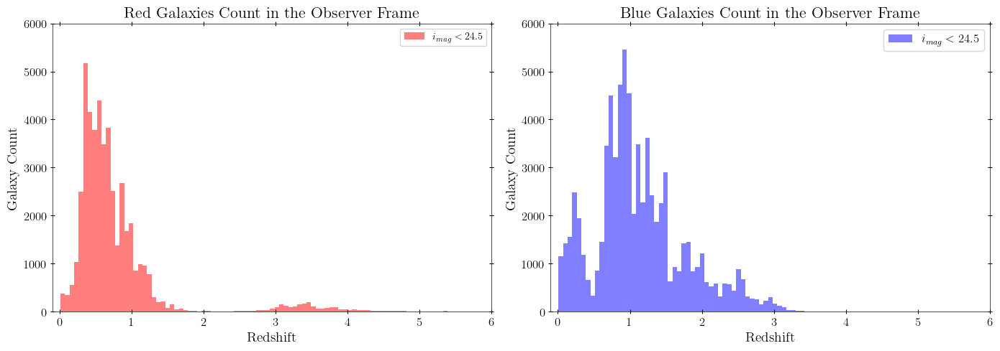

In [45]:
#Histogram in the observer frame

red_counts_array_obs = np.array([red_counts_obs[z] for z in redshift_bins_obs])
blue_counts_array_obs = np.array([blue_counts_obs[z] for z in redshift_bins_obs])

output_dir9b = 'your/path'

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))


ax1.hist(np.array(redshift_bins_obs), bins=100, weights=red_counts_array_obs, color='red', density=False, alpha=0.5, label=r'$i_{mag}<24.5$')
ax1.set_ylim(0, 6000)
ax1.set_xlim(-0.1, 6)
ax1.set_xlabel('Redshift')
ax1.set_ylabel('Galaxy Count')
ax1.set_title('Red Galaxies Count in the Observer Frame',size=16)
ax1.tick_params(axis='both', which='both', bottom=True, top=True, left=True, right=True, direction='inout', length=4)
ax1.legend(fontsize=10)


ax2.hist(np.array(redshift_bins_obs), bins=100, weights=blue_counts_array_obs, color='blue', density=False, alpha=0.5, label=r'$i_{mag}<24.5$')
ax2.set_ylim(0, 6000)
ax2.set_xlim(-0.1, 6)
ax2.set_xlabel('Redshift')
ax2.set_ylabel('Galaxy Count')
ax2.set_title('Blue Galaxies Count in the Observer Frame', size=16)
ax2.tick_params(axis='both', which='both', bottom=True, top=True, left=True, right=True, direction='inout', length=4)
ax2.legend(fontsize=12)

plt.tight_layout()
plt.savefig(os.path.join(output_dir9b, 'galaxies_hist_obs_ilim.png'), bbox_inches='tight', dpi=300)
plt.show()
plt.close()


/tmp/ipykernel_6450/2694244289.py:30: RuntimeWarning: invalid value encountered in divide
  prob_red_rest = red_counts_array_rest / total_counts_rest
/tmp/ipykernel_6450/2694244289.py:31: RuntimeWarning: invalid value encountered in divide
  prob_blue_rest = blue_counts_array_rest / total_counts_rest


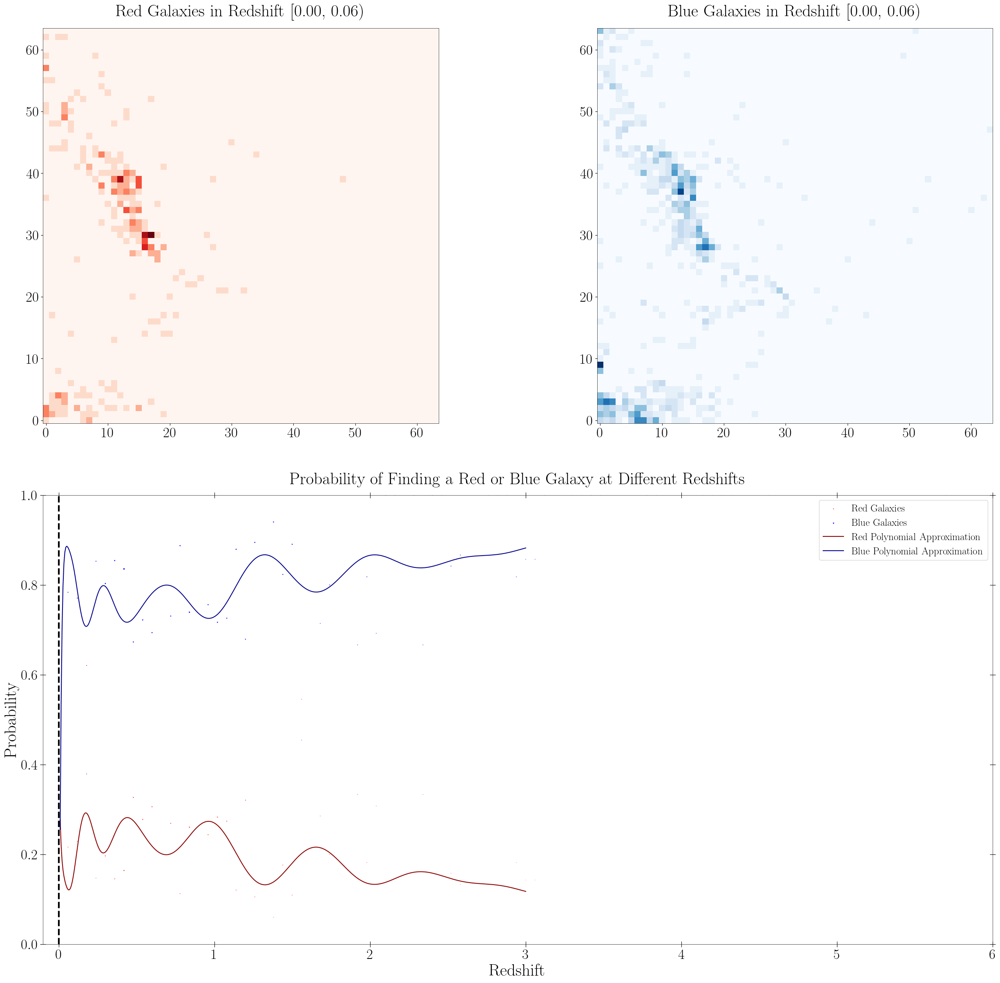

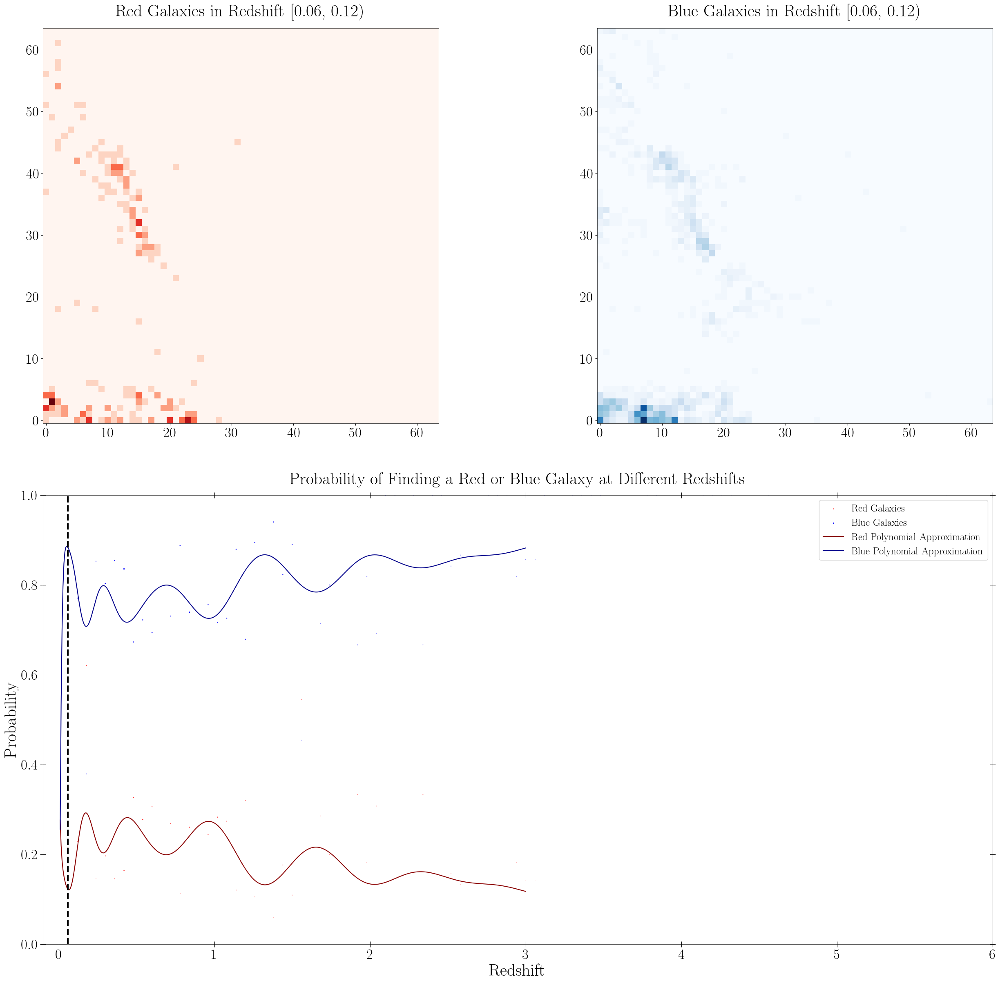

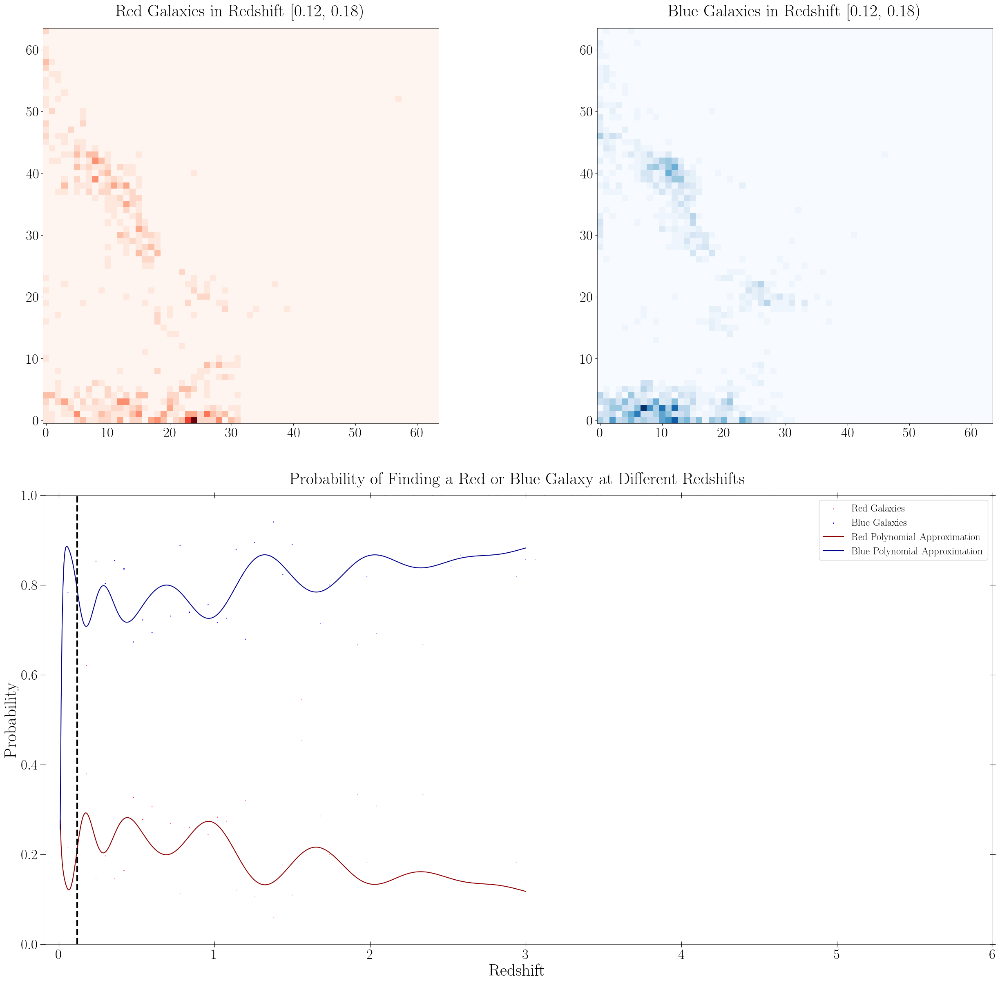

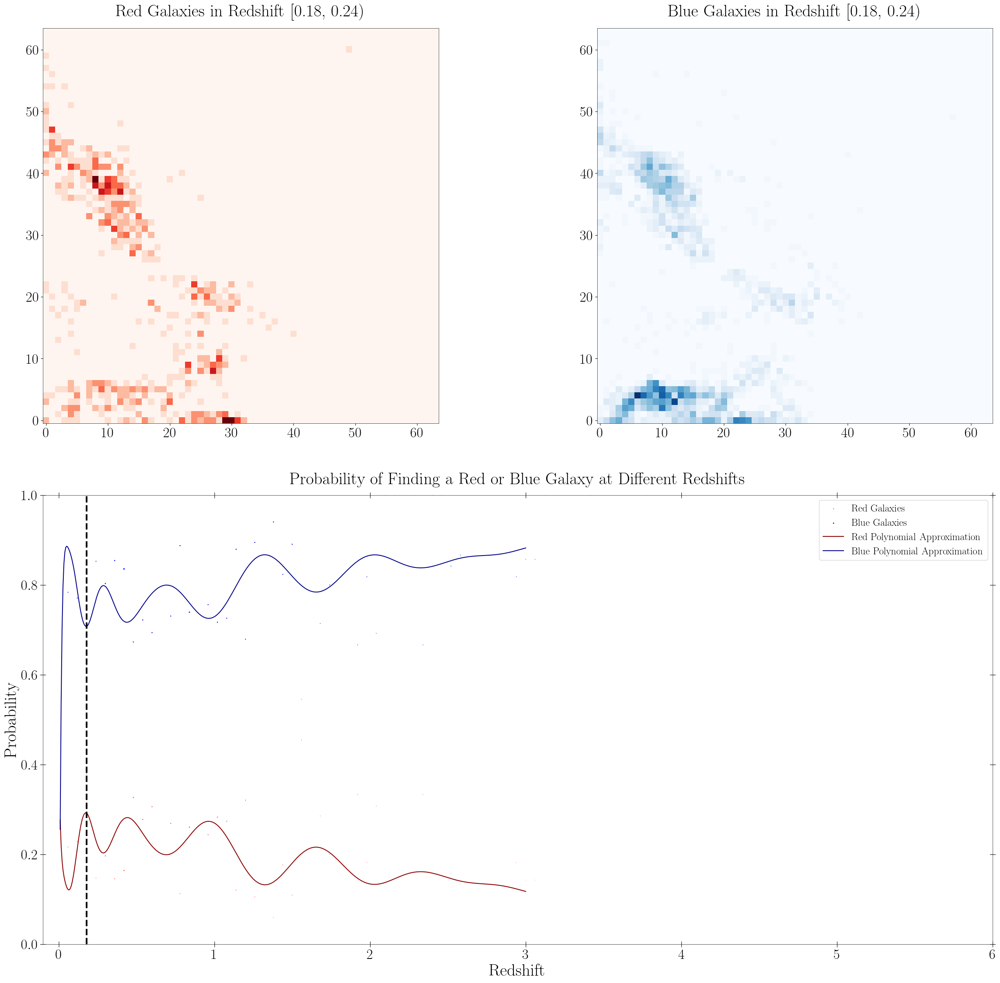

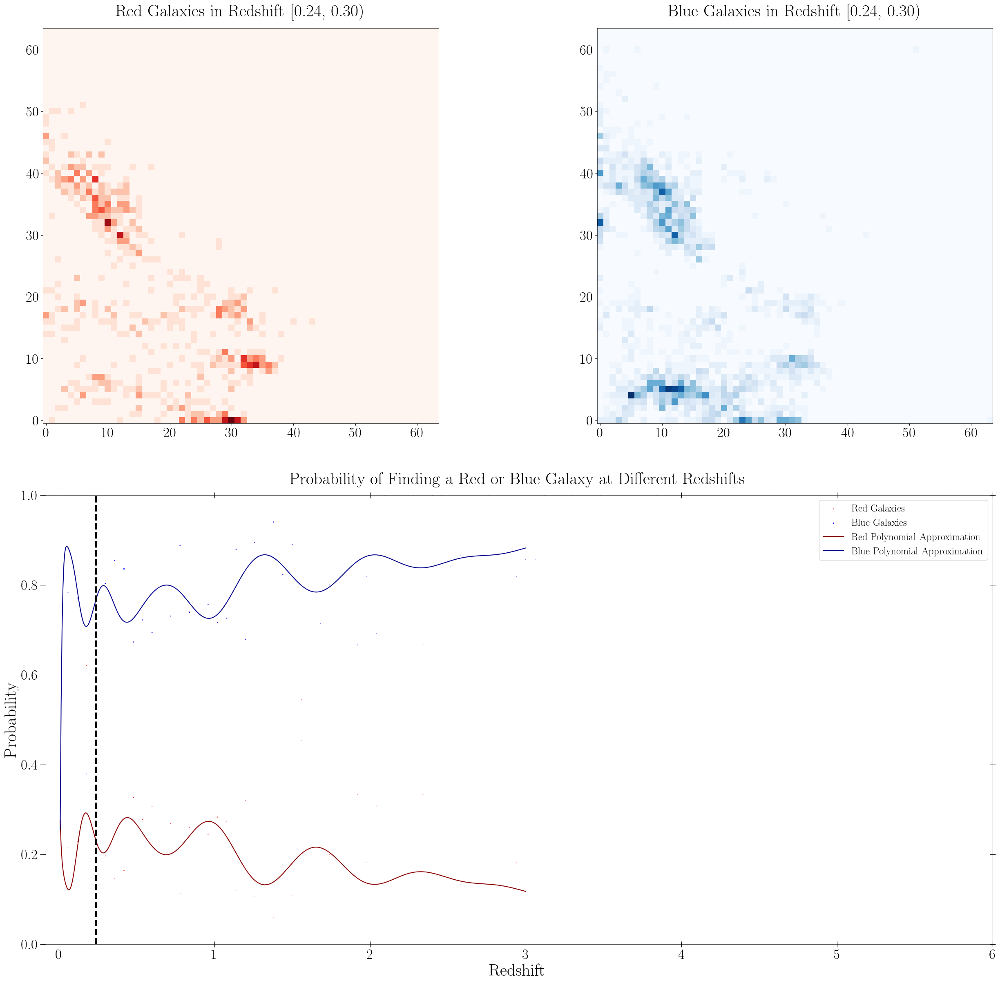

...

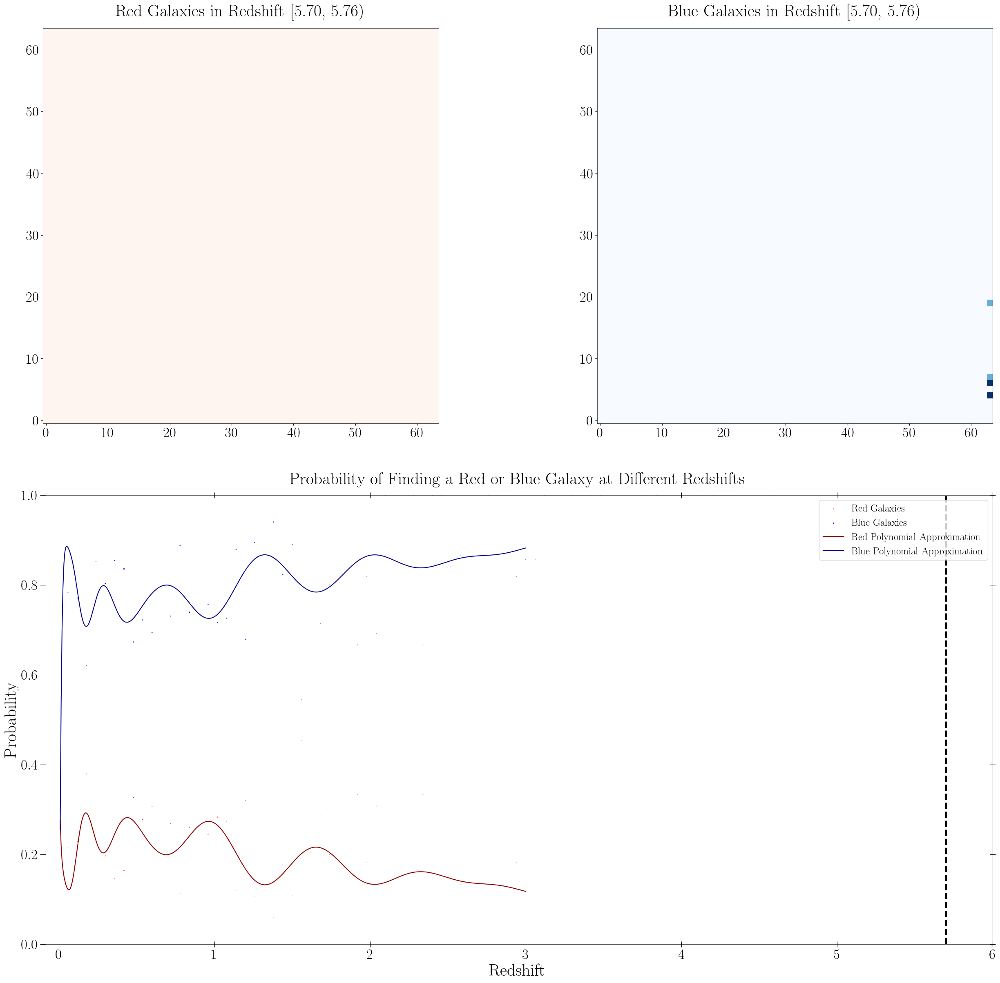

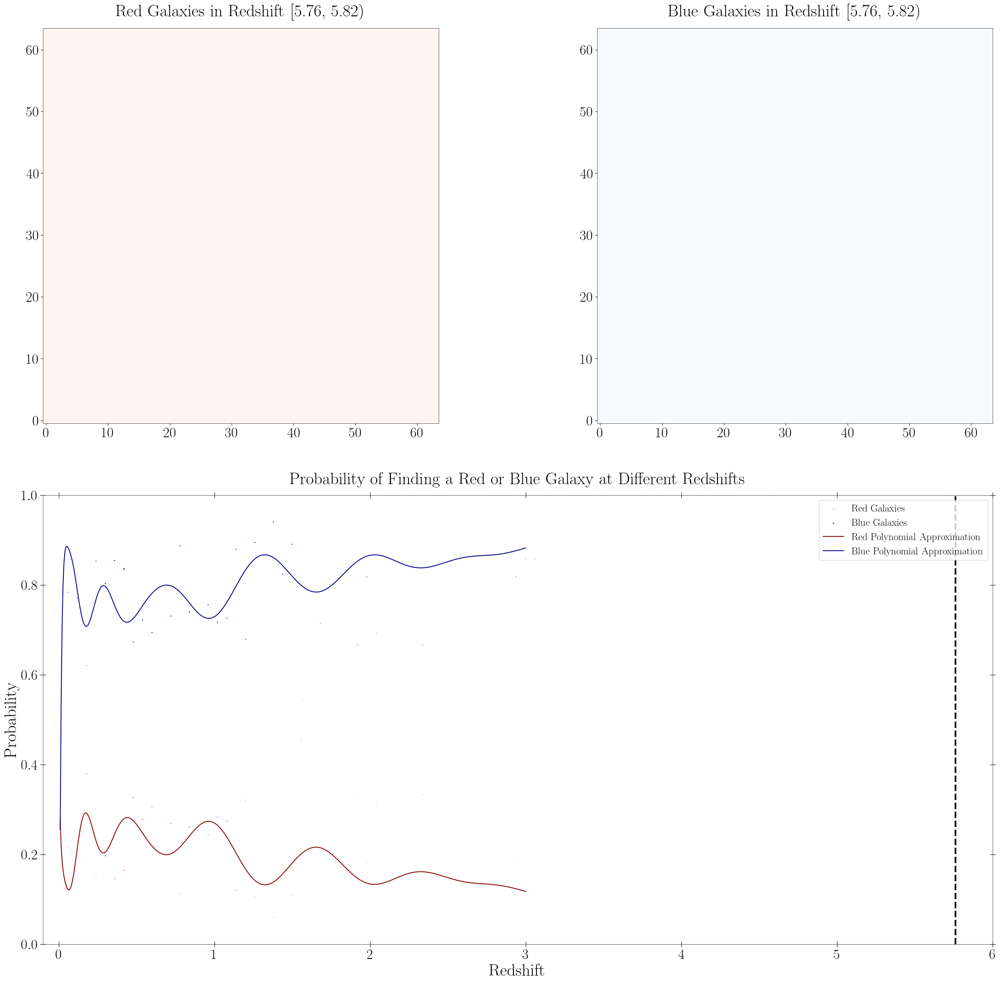

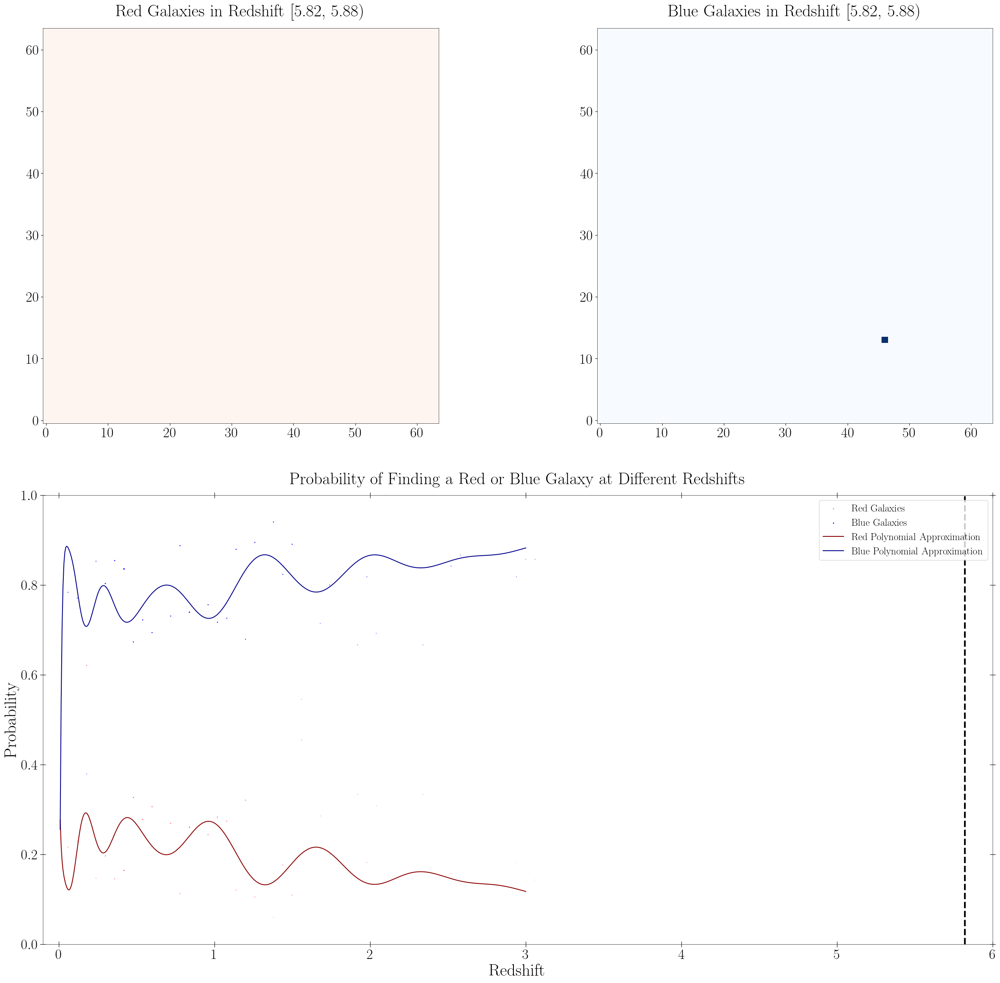

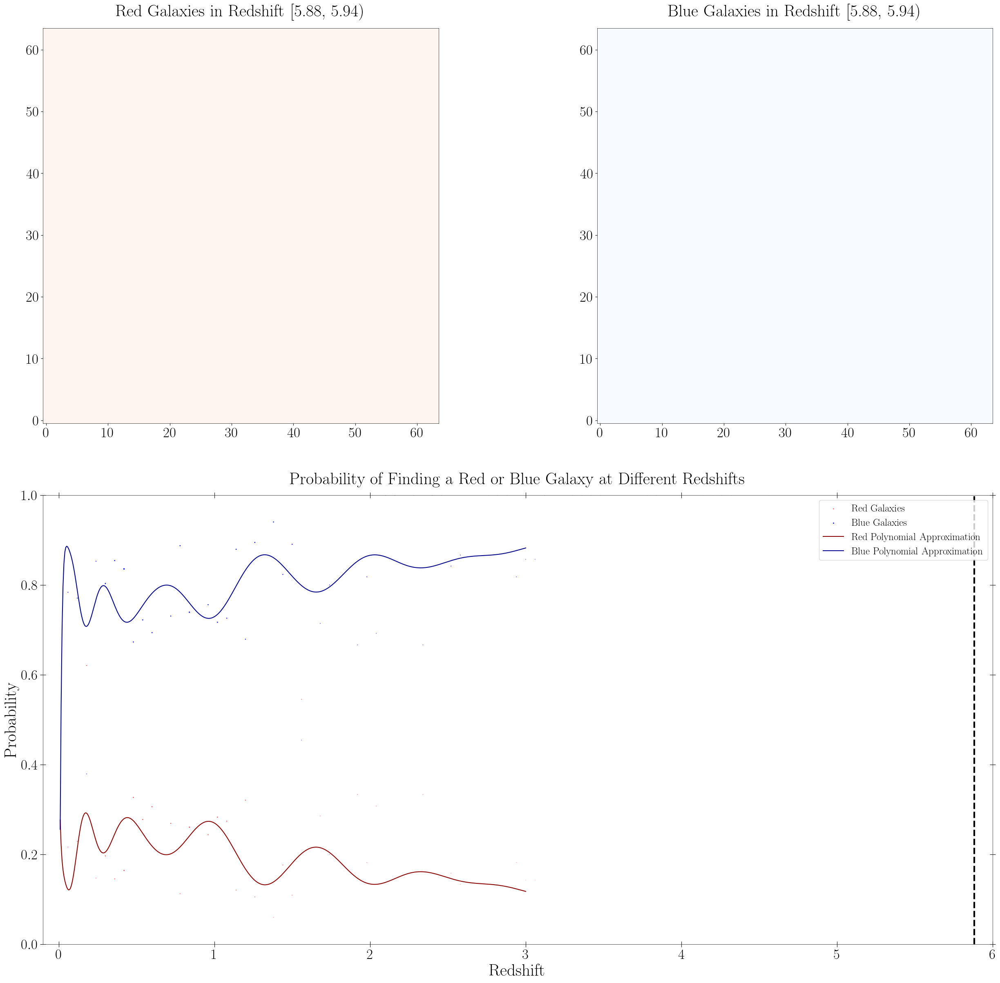

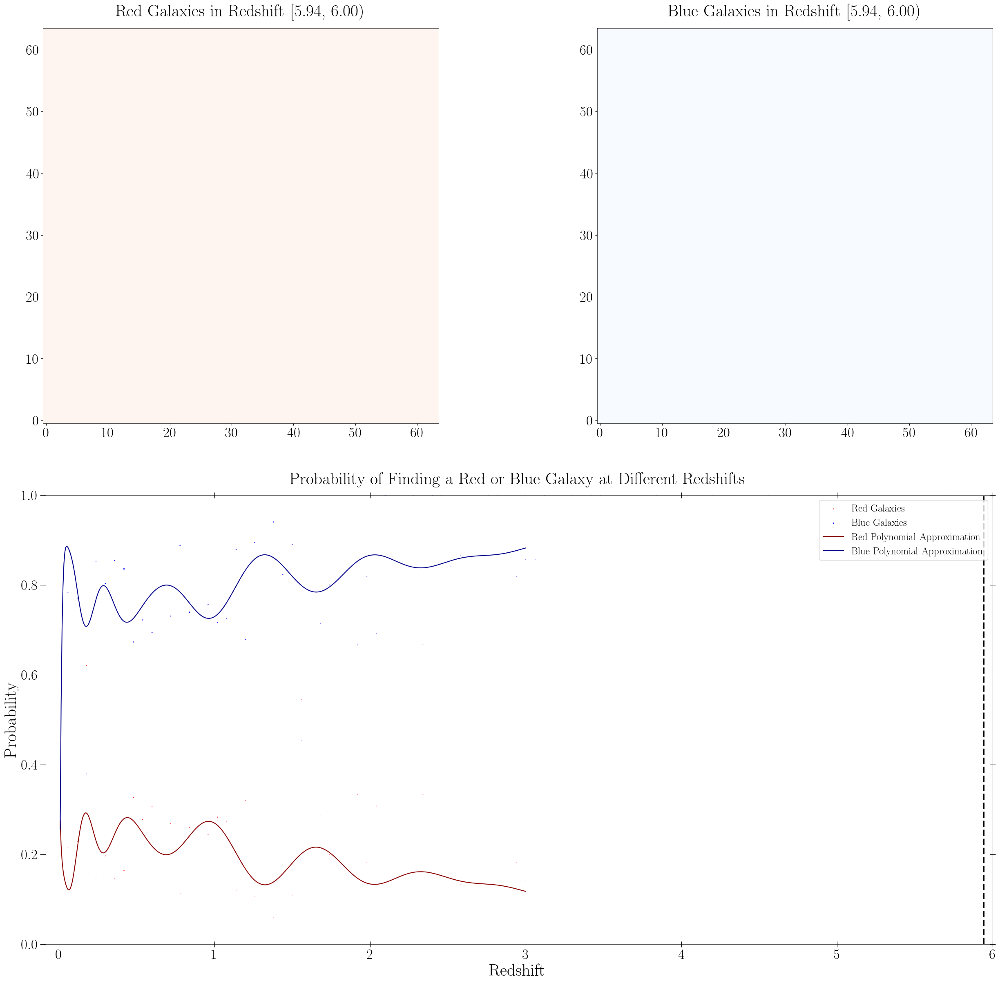

In [22]:
#Animation of the evolution of red and blue galaxies in the rest frame across redshift. 

output_dir10='your/path'

steps = 100  # Number of iterations
z_max = 6    # Maximum redshift
delta_z = z_max / steps  # Redshift interval
redshift_bins_rest = np.linspace(0, z_max, steps + 1)  # Redshift bins array (101 edges for 100 intervals)


red_counts_array_rest = np.array([red_counts_rest.get(z, 0) for z in redshift_bins_rest[:-1]]) 

blue_counts_array_rest = np.array([blue_counts_rest.get(z, 0) for z in redshift_bins_rest[:-1]])


total_counts_rest = red_counts_array_rest + blue_counts_array_rest
prob_red_rest = red_counts_array_rest / total_counts_rest  
prob_blue_rest = blue_counts_array_rest / total_counts_rest

# Debugging: Ensure array lengths match
assert len(redshift_bins_rest[:-1]) == len(prob_red_rest), "Mismatch in redshift_bins_rest and prob_red_rest lengths"
assert len(prob_red_rest) == len(prob_blue_rest), "Mismatch in prob_red_rest and prob_blue_rest lengths"


list = ['None', 'Red', 'Blue']


for s in range(steps):
    z = redshift_bins_rest[s]


    for row in data:
        if z <= row['photoz'] < redshift_bins_rest[s + 1]:
            row['band'] = s

    fig, axs = plt.subplots(2, 2, figsize=(30, 30))
    fig.subplots_adjust(hspace=0.1, wspace=0.4)

    for k in range(1, 3):  
        band_s = data[(data['band'] == s) & (data['type_rest'] == k)]
        cell_classifications = band_s['cell']


        counts, _ = np.histogram(cell_classifications, bins=somres**2, range=(0, somres**2))

        if k == 1:  
            im1 = axs[0, 0].imshow(counts.reshape(somres, somres), cmap='Reds', vmin=0)
            axs[0, 0].set_title(f'{list[k]} Galaxies in Redshift [{z:.2f}, {redshift_bins_rest[s + 1]:.2f})', fontsize=30, pad=20)
        elif k == 2:  # Blue galaxies
            im2 = axs[0, 1].imshow(counts.reshape(somres, somres), cmap='Blues', vmin=0)
            axs[0, 1].set_title(f'{list[k]} Galaxies in Redshift [{z:.2f}, {redshift_bins_rest[s + 1]:.2f})', fontsize=30, pad=20)

    fig.delaxes(axs[1, 0])
    fig.delaxes(axs[1, 1])


    ax_bottom = fig.add_subplot(2, 1, 2)
    ax_bottom.scatter(redshift_bins_rest[:-1], prob_red_rest, s=0.01 * red_counts_array_rest, color='red', label='Red Galaxies')
    ax_bottom.scatter(redshift_bins_rest[:-1], prob_blue_rest, s=0.01 * blue_counts_array_rest, color='blue', label='Blue Galaxies')
    ax_bottom.plot(x_new_rest, y_red_new_rest, color='darkred', label='Red Polynomial Approximation')
    ax_bottom.plot(x_new_rest, y_blue_new_rest, color='darkblue', label='Blue Polynomial Approximation')
    ax_bottom.set_xlabel('Redshift', fontsize=30)
    ax_bottom.set_ylabel('Probability', fontsize=30)
    ax_bottom.set_xlim(-0.1, z_max)
    ax_bottom.set_ylim(0, 1)
    ax_bottom.set_title('Probability of Finding a Red or Blue Galaxy at Different Redshifts', fontsize=30, pad=20)
    ax_bottom.legend(loc='upper right', fontsize=18)
    ax_bottom.axvline(x=z, linewidth=3, color='black', ymin=0, ymax=1, linestyle="dashed")

    ax_bottom.tick_params(axis='both', which='both', bottom=True, top=True, left=True, right=True, direction='inout', length=10)


    axs[0, 0].invert_yaxis()
    axs[0, 1].invert_yaxis()

    plt.savefig(os.path.join(output_dir10, 'r_b_SomProb.png'), bbox_inches='tight', dpi=300)
    plt.show()
    plt.close()
